In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
plt.style.use('ggplot')

In [5]:
df = pd.read_csv("C:/Data Science/data/consolidated.csv")

In [2]:
from nltk.sentiment import SentimentIntensityAnalyzer
from tqdm.notebook import tqdm

sia = SentimentIntensityAnalyzer()

In [7]:
df['NewID'] = range(1, len(df) + 1)
df.head(3)

,Search Term,ID,Title,Author,Date Uploaded,Views,Likes_x,Subscriber Count,Country,Comment,Likes_y,AuthorChannelId,PublishedAt,VideoID,NewID
0,3090,-sVvf1A41IQ,RTX 3090 Ti vs Power Supply,NikTek,2022-01-06T15:03:27Z,453321,19909.0,390000.0,Unknown,"Thank You for watching this Video, If you enjo...",466.0,UCOOMgoGO9PwAb65v6Zyj43w,2022-01-06T15:05:58Z,NaN,1
1,3090,-sVvf1A41IQ,RTX 3090 Ti vs Power Supply,NikTek,2022-01-06T15:03:27Z,453321,19909.0,390000.0,Unknown,"Literally, You would need to mount a f nuclear...",2023.0,UCvOuwNiwb_ZpY7okvtIl4NQ,2022-01-06T15:21:04Z,NaN,2
2,3090,-sVvf1A41IQ,RTX 3090 Ti vs Power Supply,NikTek,2022-01-06T15:03:27Z,453321,19909.0,390000.0,Unknown,At this point it would make more sense to just...,1502.0,UCGQHDdyBVyvsAEsSiFqzApQ,2022-01-06T15:59:16Z,NaN,3


In [8]:
from nltk.sentiment import SentimentIntensityAnalyzer
sia = SentimentIntensityAnalyzer()

res = {}
for i, row in df.iterrows():
    text = str(row['Comment'])
    if text in ['nan', '']:
        continue
    new_id = row['NewID']  # Use the new unique identifier
    res[new_id] = sia.polarity_scores(text)

# Now 'res' will have unique keys for each row based on 'NewID'

In [9]:
from transformers import AutoTokenizer
from transformers import AutoModelForSequenceClassification
from scipy.special import softmax
import torch


In [10]:
MODEL = f"cardiffnlp/twitter-roberta-base-sentiment"
tokenizer = AutoTokenizer.from_pretrained(MODEL)
model = AutoModelForSequenceClassification.from_pretrained(MODEL)
# Move the model to GPU
if torch.cuda.is_available():
    model.cuda()

In [12]:
def polarity_scores_roberta(example):
    # Tokenize the input text; this is where encoded_text is defined
    encoded_text = tokenizer(example, return_tensors='pt')
    
    # Check if a GPU is available and move the encoded text to GPU
    if torch.cuda.is_available():
        encoded_text = encoded_text.to('cuda')  # Move encoded text to the same device as the model
        
    # Perform the prediction
    output = model(**encoded_text)
    
    # Detach the output and move it back to CPU for further processing with NumPy
    scores = output[0][0].detach().cpu().numpy()
    scores = softmax(scores)
    
    # Construct the scores dictionary
    scores_dict = {
        'roberta_neg': scores[0],
        'roberta_neu': scores[1],
        'roberta_pos': scores[2]
    }
    
    return scores_dict

In [ ]:
from tqdm import tqdm

res = {}
for i, row in tqdm(df.iterrows(), total=len(df)):
    try: #for text too large
        text = row['Comment']
        # Convert to string in case of NaN or float
        text = str(text) if pd.notnull(text) else ""
        myid = row['NewID']
        if text:  # Proceed only if text is not empty
            vader_result = sia.polarity_scores(text)
            vader_result_rename = {f"vader_{key}": value for key, value in vader_result.items()}
            roberta_result = polarity_scores_roberta(text)
            both = {**vader_result_rename, **roberta_result}
            res[myid] = both
    except RuntimeError as e:
        print(f'Broke for id {myid}: {str(e)}')

In [13]:
gpus = tf.config.list_physical_devices('GPU')
if gpus: 
    tf.config.set_logical_device_configuration(
        gpus[0],[tf.config.LogicalDeviceConfiguration(memory_limit=12000)]
    )

logical_gpus = tf.config.list_logical_devices('GPU')
print(len(gpus), "Physical GPU,", len(logical_gpus), "Logical GPUs")

1 Physical GPU, 1 Logical GPUs


In [ ]:
print(torch.cuda.memory_summary())  # Provides a detailed summary of GPU memory management.


In [14]:
def polarity_scores_roberta(batch_examples):
    # Tokenize the batch of input text
    encoded_batch = tokenizer(batch_examples, return_tensors='pt', padding=True, truncation=True, max_length=512)
    
    # Check if a GPU is available and move the encoded batch to GPU
    if torch.cuda.is_available():
        encoded_batch = {k: v.to('cuda') for k, v in encoded_batch.items()}
    
    # Perform the prediction
    with torch.no_grad():
        outputs = model(**encoded_batch)
    
    # Move the outputs back to CPU for further processing with NumPy
    scores = outputs.logits.detach().cpu().numpy()
    scores = softmax(scores, axis=1)
    
    return scores


In [15]:
def softmax(x, axis=None):
    e_x = np.exp(x - np.max(x, axis=axis, keepdims=True))
    return e_x / np.sum(e_x, axis=axis, keepdims=True)


In [16]:
from tqdm import tqdm
import numpy as np

batch_size = 256  # Define your batch size

# Initialize results dictionary
res = {}

# Process the DataFrame in batches
for i in tqdm(range(0, len(df), batch_size), total=np.ceil(len(df)/batch_size)):
    batch_df = df.iloc[i:i+batch_size]
    texts = batch_df['Comment'].fillna("").astype(str).tolist()  # Handle missing values and ensure string type
    ids = batch_df['NewID'].tolist()
    
    # Compute VADER scores (still one at a time since VADER does not support batching)
    vader_scores = [sia.polarity_scores(text) for text in texts]
    
    # Compute RoBERTa scores in batch
    roberta_scores = polarity_scores_roberta(texts)
    
    # Combine VADER and RoBERTa scores
    for idx, myid in enumerate(ids):
        vader_result_rename = {f"vader_{key}": value for key, value in vader_scores[idx].items()}
        roberta_result = {
            'roberta_neg': roberta_scores[idx][0],
            'roberta_neu': roberta_scores[idx][1],
            'roberta_pos': roberta_scores[idx][2],
        }
        both = {**vader_result_rename, **roberta_result}
        res[myid] = both

100%|██████████| 475/475.0 [11:26<00:00,  1.45s/it]


In [22]:
results_df = pd.DataFrame(res).T
results_df = results_df.reset_index().rename(columns={'index':'NewID'})
results_df = results_df.merge(df, how='left')

In [24]:
results_df.to_csv("C:\Data Science\data\processed\Youtube\consolidated.csv")

In [3]:
results_df = pd.read_csv("C:\Data Science\data\processed\Youtube\consolidated.csv")

In [ ]:
df.head()

In [1]:
df.columns

NameError: name 'df' is not defined

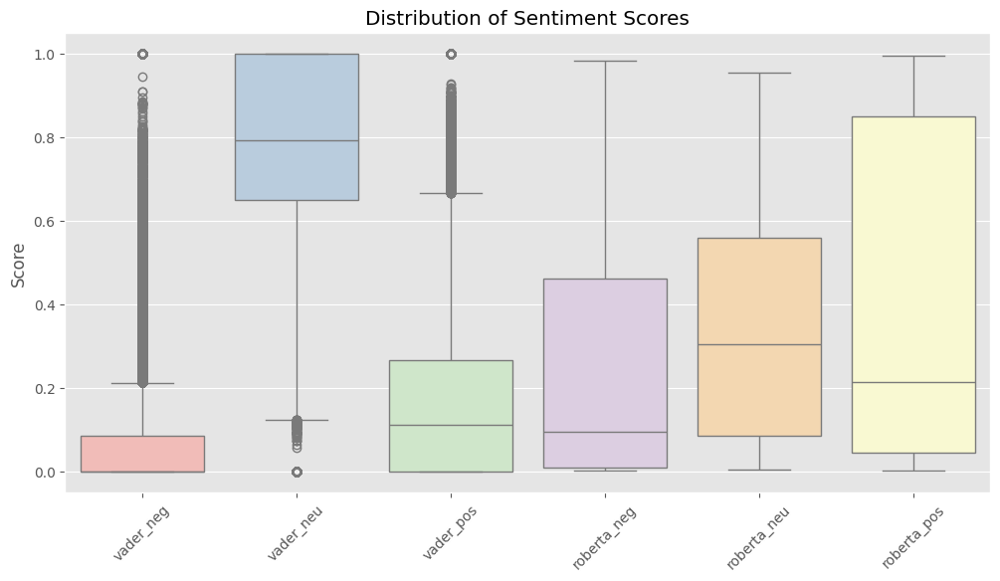

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming your DataFrame is named 'results_df'
# Plotting boxplots for sentiment scores
plt.figure(figsize=(12, 6))  # Set figure size for better readability
sns.boxplot(data=df[['vader_neg', 'vader_neu', 'vader_pos',
                             'roberta_neg', 'roberta_neu', 'roberta_pos']],
            palette='Pastel1')

plt.title('Distribution of Sentiment Scores')
plt.ylabel('Score')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.show()

In [8]:
sns.pairplot(data=df,
             vars=['vader_neg', 'vader_neu', 'vader_pos',
                  'roberta_neg', 'roberta_neu', 'roberta_pos'],
            hue='Title',
            palette='tab10')
plt.show()

c:\Data Science\venv\lib\site-packages\seaborn\utils.py:61: UserWarning: Glyph 9203 (\N{HOURGLASS WITH FLOWING SAND}) missing from current font.
  fig.canvas.draw()
c:\Data Science\venv\lib\site-packages\seaborn\utils.py:61: UserWarning: Glyph 129297 (\N{MONEY-MOUTH FACE}) missing from current font.
  fig.canvas.draw()
c:\Data Science\venv\lib\site-packages\seaborn\utils.py:61: UserWarning: Glyph 24859 (\N{CJK UNIFIED IDEOGRAPH-611B}) missing from current font.
  fig.canvas.draw()
c:\Data Science\venv\lib\site-packages\seaborn\utils.py:61: UserWarning: Glyph 12398 (\N{HIRAGANA LETTER NO}) missing from current font.
  fig.canvas.draw()
c:\Data Science\venv\lib\site-packages\seaborn\utils.py:61: UserWarning: Glyph 12358 (\N{HIRAGANA LETTER U}) missing from current font.
  fig.canvas.draw()
c:\Data Science\venv\lib\site-packages\seaborn\utils.py:61: UserWarning: Glyph 12383 (\N{HIRAGANA LETTER TA}) missing from current font.
  fig.canvas.draw()
c:\Data Science\venv\lib\site-packages\seabo

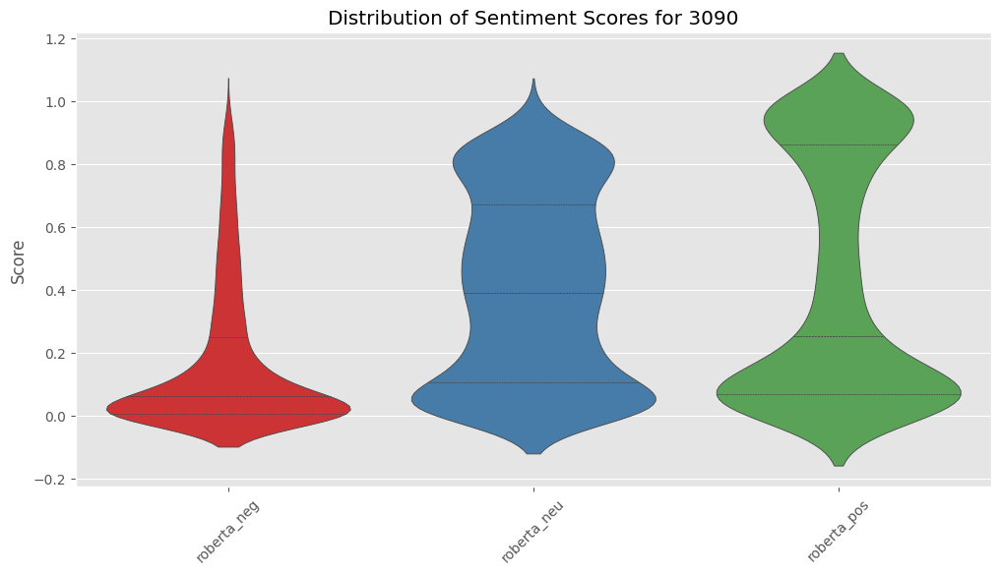

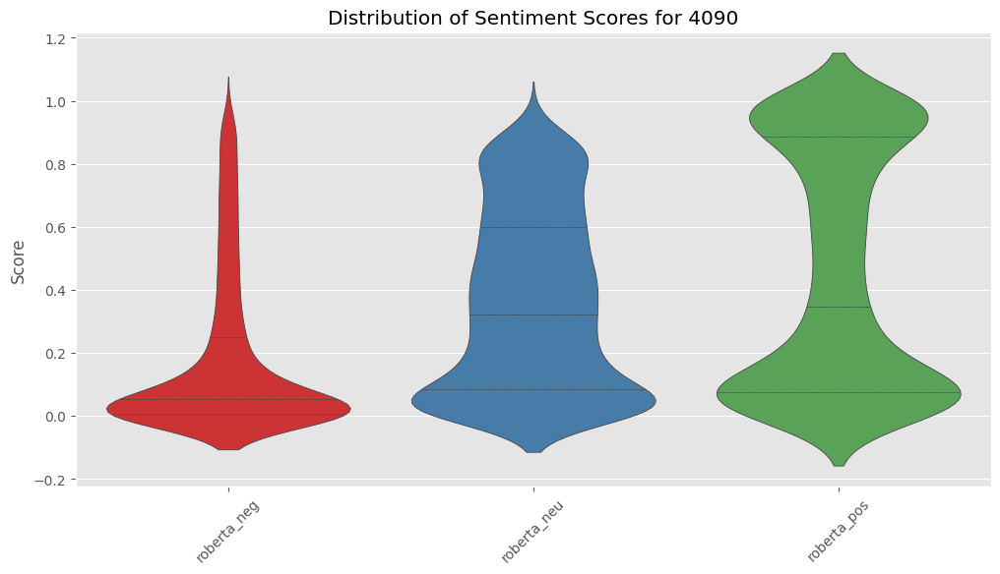

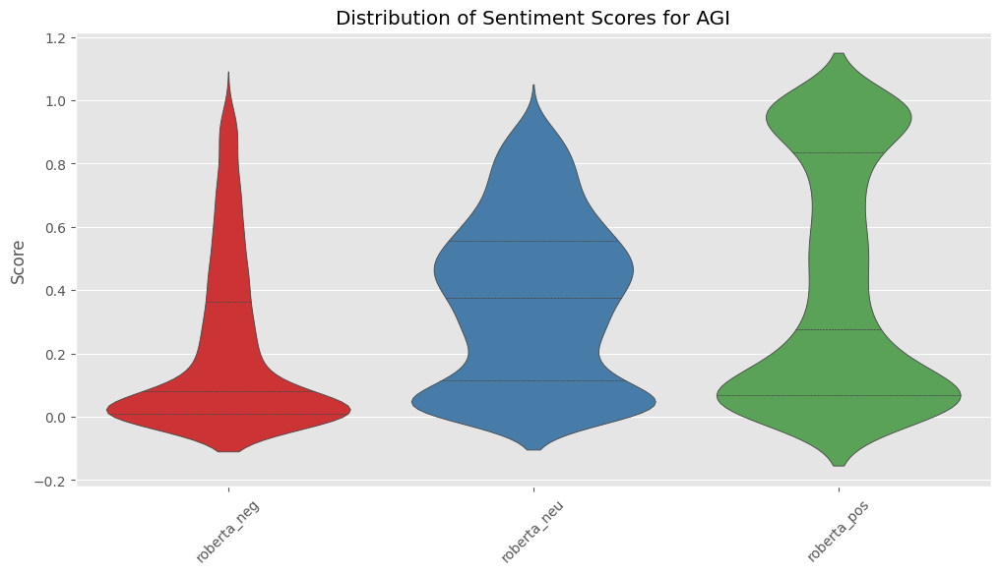

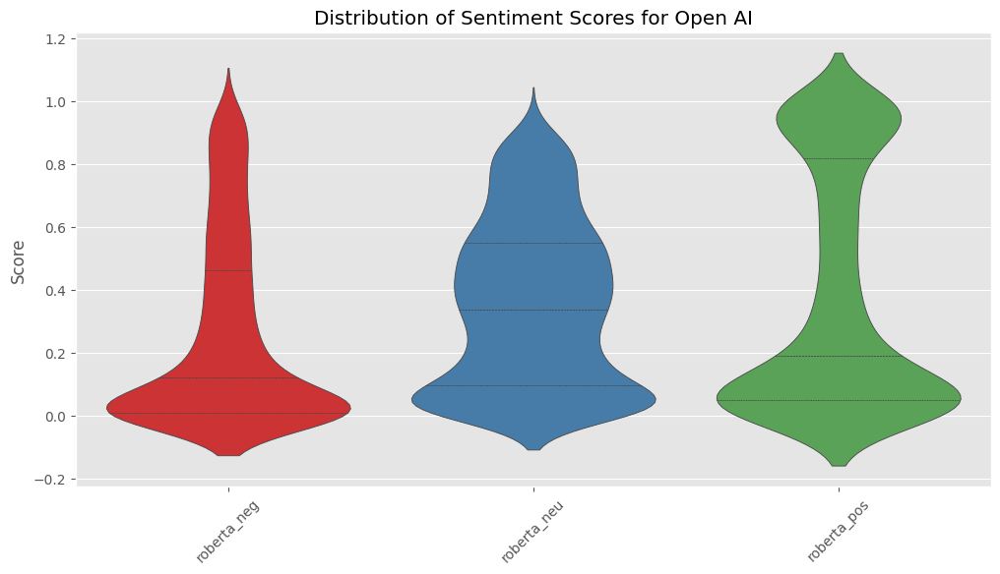

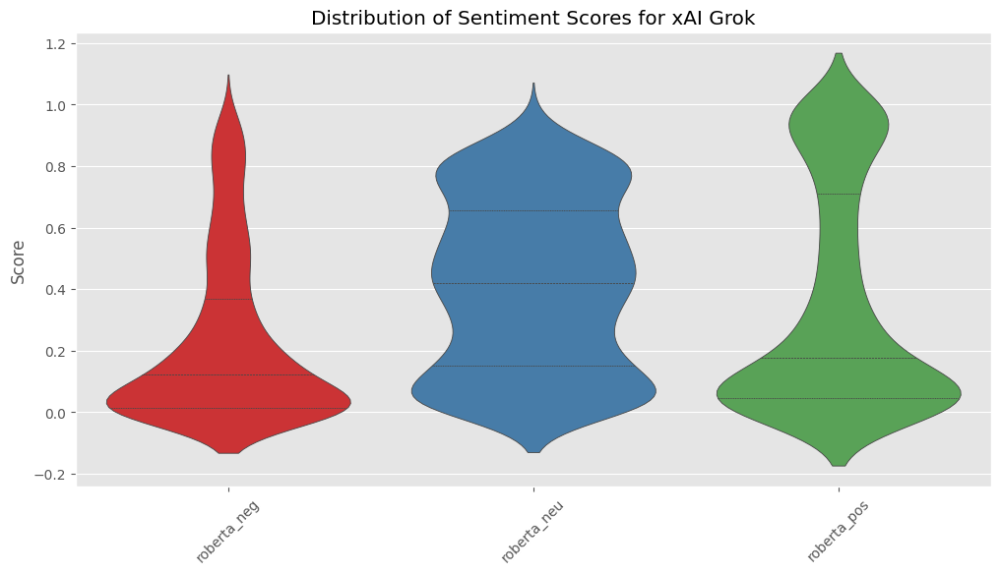

...

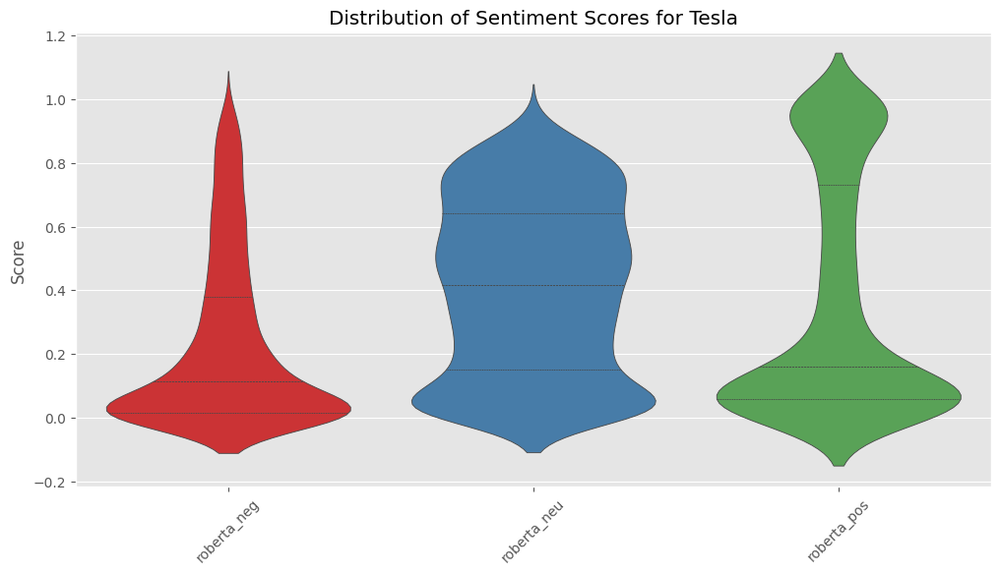

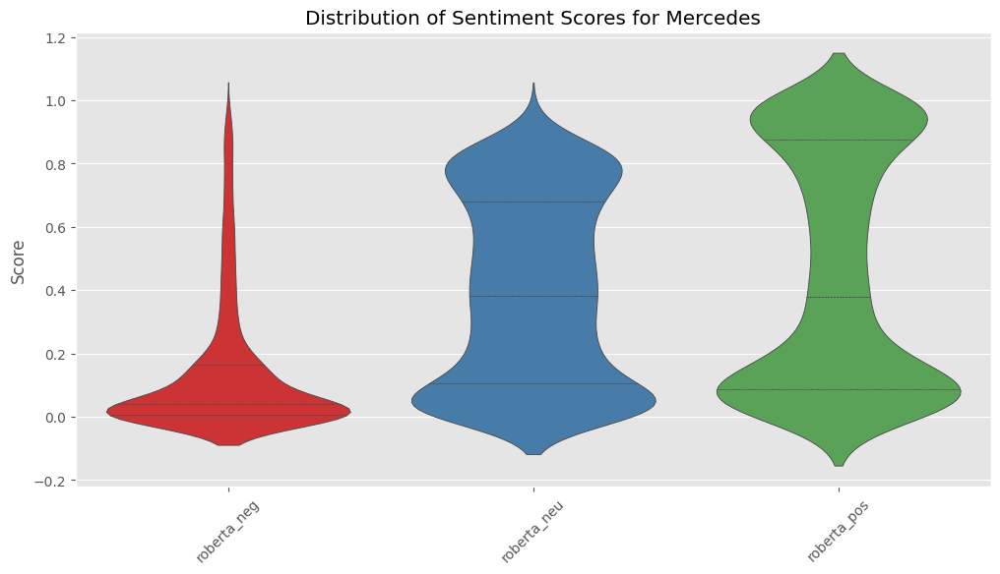

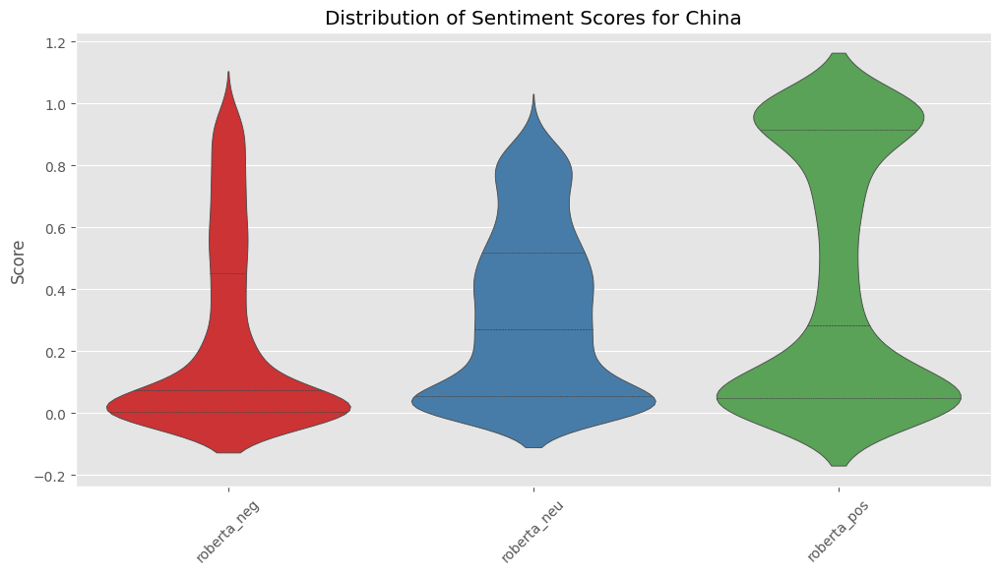

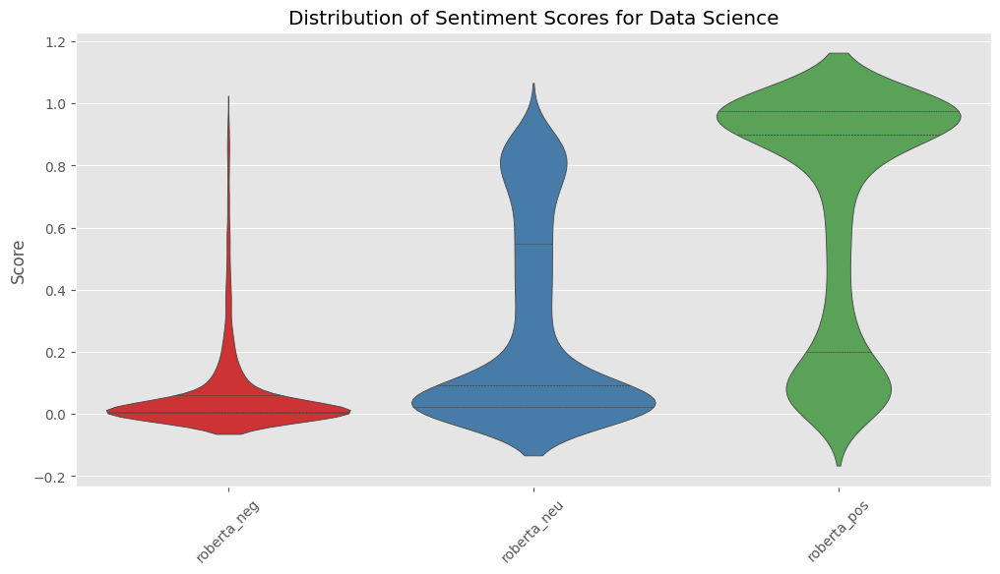

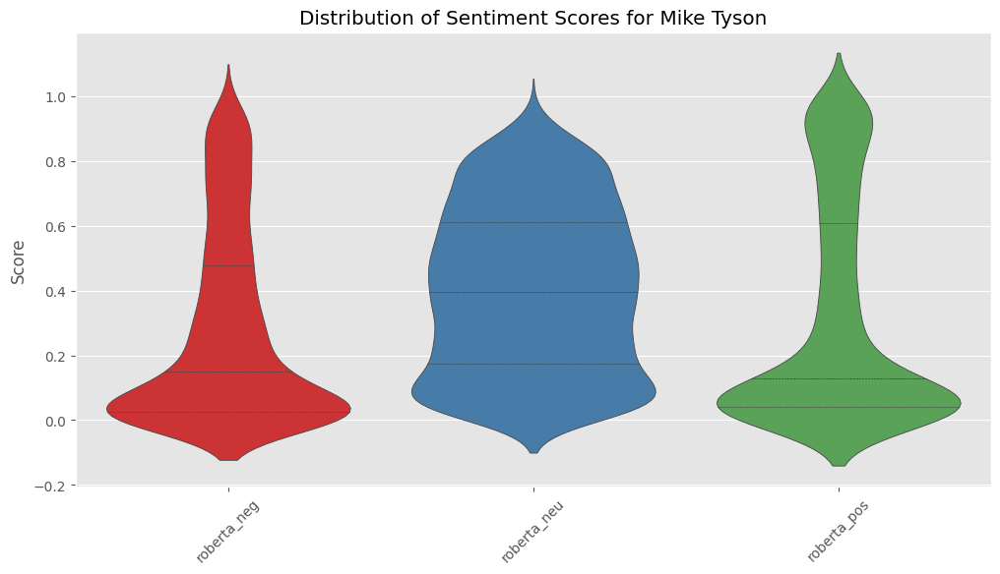

In [52]:
import seaborn as sns
import matplotlib.pyplot as plt

# List of search terms
search_term = ['3090', '4090', 'AGI', 'Open AI', 'xAI Grok', 'Copilot', 'Sora',
               'Andrew Tate', 'Ben Shapiro', 'Candace Owens', 'Jordan Peterson', 
               'Antisemitism', 'Islamophobia', 'Extremism', 'Apple', 'Samsung', 
               'Pixel 8', 'iphone', 'Samsung S24', 'AMD', 'Nvidia', 'Intel', 
               'Microsoft', 'Christianity', 'islam', 'Judaism', 'Justin Trudeau', 
               'Kier Starmer', 'Biden', 'Michael Gove', 'Rishi Sunak', 'Sadiq Khan', 
               'Netanyahu', 'Putin', 'Labour', 'Tories', 'Israel', 'Gaza', 'Arsenal', 
               'Liverpool FC', 'FC Porto', 'Manchester United', 'Max Verstapen', 
               'Charles Leclerc', 'Lewis Hamilton', 'Bitcoin', 'Crypto', 'Ford', 
               'Tesla', 'Mercedes', 'China', 'Data Science', 'Mike Tyson']

# Assuming your DataFrame is named 'results_df'
for i in search_term:
    # Filter the DataFrame to only include rows with the current search term
    filtered_df = results_df[results_df['Search Term'] == i]

    # Plot the violin plots for sentiment scores of the filtered DataFrame
    plt.figure(figsize=(12, 6))
    sns.violinplot(data=filtered_df[['roberta_neg', 'roberta_neu', 'roberta_pos']],
                   palette='Set1', inner='quartile')

    plt.title(f'Distribution of Sentiment Scores for {i}')
    plt.ylabel('Score')
    plt.xticks(rotation=45)
    plt.show()



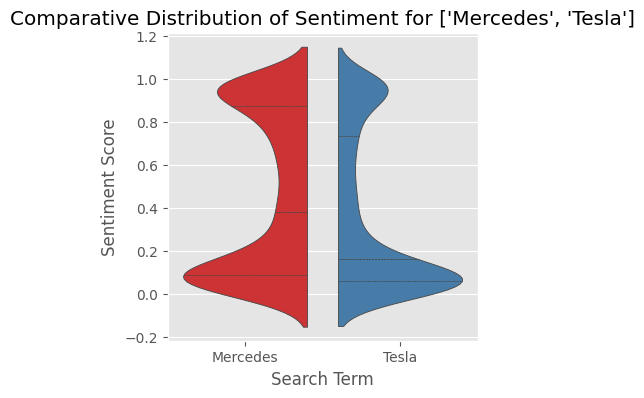

In [71]:
import seaborn as sns
import matplotlib.pyplot as plt

# List of two specific search terms you want to compare
search_terms_to_compare = ['Mercedes', 'Tesla']  # Replace with your actual search terms

# Assuming your DataFrame is named 'results_df'
# Filter the DataFrame to include only rows with the specified search terms
filtered_df = results_df[results_df['Search Term'].isin(search_terms_to_compare)]

# Assuming the sentiment score column you want to compare is 'roberta_pos'
# Here you can replace 'roberta_pos' with 'roberta_neg' or 'roberta_neu', etc.
# Create the violin plot
plt.figure(figsize=(4, 4))
sns.violinplot(x="Search Term", y="roberta_pos", hue="Search Term",
               split=True, data=filtered_df, inner="quartile", palette="Set1", gap=0)

plt.title(f'Comparative Distribution of Sentiment for {search_terms_to_compare}')
plt.ylabel('Sentiment Score')
plt.show()


In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# List of two specific search terms you want to compare
search_terms_to_compare = ['Mercedes', 'Tesla']  # Replace with your actual search terms

# Filter the DataFrame to include only rows with the specified search terms
filtered_df = results_df[results_df['Search Term'].isin(search_terms_to_compare)]

# We will now reshape the DataFrame to have the sentiment scores stacked,
# so we have one column for sentiment types and another for scores.
# Assuming your sentiment score columns are named 'roberta_pos', 'roberta_neu', and 'roberta_neg'
melted_df = pd.melt(filtered_df, id_vars=['Search Term'], value_vars=['roberta_pos', 'roberta_neu', 'roberta_neg'],
                    var_name='Sentiment Type', value_name='Score')

# Now, we can use seaborn to create a bar plot with this reshaped DataFrame
plt.figure(figsize=(12, 6))
sns.barplot(data=melted_df, x='Search Term', y='Score', hue='Sentiment Type', palette='Set1')

plt.title('Average Sentiment Scores for Mercedes vs Tesla')
plt.ylabel('Average Sentiment Score')
plt.xlabel('Search Term')
plt.legend(title='Sentiment Type')
plt.show()


NameError: name 'results_df' is not defined

In [9]:
sns.displot(data=melted_df, x='Search Term', col='Score', kde=True)

NameError: name 'melted_df' is not defined